# Basic imports and global variables

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import zipfile
from PIL import Image
import cv2
from skimage import io
import tensorflow as tf
from tensorflow.python.keras import Sequential
from tensorflow.keras import layers, optimizers
from tensorflow.keras.applications import ResNet50, ResNet101
from tensorflow.keras.applications import ResNet101V2
from tensorflow.keras.layers import *
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.initializers import glorot_uniform
from tensorflow.keras.utils import plot_model
from tensorflow.keras.callbacks import ReduceLROnPlateau, EarlyStopping, ModelCheckpoint, LearningRateScheduler, TensorBoard
from IPython.display import display
from tensorflow.keras import backend as K
from sklearn.preprocessing import StandardScaler, normalize
import os
import datetime
import glob
import random
import tensorflow_io as tfio
from tensorflow.keras.mixed_precision import experimental as mixed_precision
%matplotlib inline

In [2]:
BASE_FOLDER = os.getcwd()
DATASET_FOLDER = os.path.join("Dataset", "Brain_MRI")
MODEL_FOLDER = "Models"
SEED = 2020
BATCH_SIZE = 32

In [3]:
tf.random.set_seed(SEED)
os.environ['PYTHONHASHSEED'] = str(SEED)
np.random.seed(SEED)
random.seed(SEED)

In [4]:
#Set mixed precision
policy = mixed_precision.Policy('mixed_float16')
mixed_precision.set_policy(policy)

INFO:tensorflow:Mixed precision compatibility check (mixed_float16): OK
Your GPU will likely run quickly with dtype policy mixed_float16 as it has compute capability of at least 7.0. Your GPU: GeForce RTX 2080 SUPER, compute capability 7.5


# Data exploration

In [5]:
brain_df = pd.read_csv(os.path.join(DATASET_FOLDER, 'data_mask.csv'))

In [6]:
brain_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3929 entries, 0 to 3928
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   patient_id  3929 non-null   object
 1   image_path  3929 non-null   object
 2   mask_path   3929 non-null   object
 3   mask        3929 non-null   int64 
dtypes: int64(1), object(3)
memory usage: 122.9+ KB


In [7]:
brain_df.head(10)

,patient_id,image_path,mask_path,mask
0,TCGA_CS_5395_19981004,TCGA_CS_5395_19981004/TCGA_CS_5395_19981004_1.tif,TCGA_CS_5395_19981004/TCGA_CS_5395_19981004_1_...,0
1,TCGA_CS_5395_19981004,TCGA_CS_4944_20010208/TCGA_CS_4944_20010208_1.tif,TCGA_CS_4944_20010208/TCGA_CS_4944_20010208_1_...,0
2,TCGA_CS_5395_19981004,TCGA_CS_4941_19960909/TCGA_CS_4941_19960909_1.tif,TCGA_CS_4941_19960909/TCGA_CS_4941_19960909_1_...,0
3,TCGA_CS_5395_19981004,TCGA_CS_4943_20000902/TCGA_CS_4943_20000902_1.tif,TCGA_CS_4943_20000902/TCGA_CS_4943_20000902_1_...,0
4,TCGA_CS_5395_19981004,TCGA_CS_5396_20010302/TCGA_CS_5396_20010302_1.tif,TCGA_CS_5396_20010302/TCGA_CS_5396_20010302_1_...,0
5,TCGA_CS_5395_19981004,TCGA_CS_5393_19990606/TCGA_CS_5393_19990606_1.tif,TCGA_CS_5393_19990606/TCGA_CS_5393_19990606_1_...,0
6,TCGA_CS_5395_19981004,TCGA_CS_4942_19970222/TCGA_CS_4942_19970222_1.tif,TCGA_CS_4942_19970222/TCGA_CS_4942_19970222_1_...,0
7,TCGA_CS_5395_19981004,TCGA_CS_5397_20010315/TCGA_CS_5397_20010315_1.tif,TCGA_CS_5397_20010315/TCGA_CS_5397_20010315_1_...,0
8,TCGA_CS_5395_19981004,TCGA_CS_6188_20010812/TCGA_CS_6188_20010812_1.tif,TCGA_CS_6188_20010812/TCGA_CS_6188_20010812_1_...,0
9,TCGA_CS_5395_19981004,TCGA_CS_6666_20011109/TCGA_CS_6666_20011109_1.tif,TCGA_CS_6666_20011109/TCGA_CS_6666_20011109_1_...,0


In [8]:
brain_df.mask_path[1] # Path to the brain MRI image

'TCGA_CS_4944_20010208/TCGA_CS_4944_20010208_1_mask.tif'

In [9]:
brain_df.image_path[1] # Path to the segmentation mask

'TCGA_CS_4944_20010208/TCGA_CS_4944_20010208_1.tif'

In [10]:
brain_df["mask"].value_counts()

0    2556
1    1373
Name: mask, dtype: int64

In [11]:
brain_df['mask'].value_counts().index

Int64Index([0, 1], dtype='int64')

In [12]:
import plotly.graph_objects as go

fig = go.Figure([go.Bar(x = brain_df['mask'].value_counts().index, y = brain_df['mask'].value_counts())])
fig.update_traces(marker_color = 'rgb(0,200,0)', marker_line_color = 'rgb(0,255,0)',
                  marker_line_width = 7, opacity = 0.6)
fig.show()

## Visualization

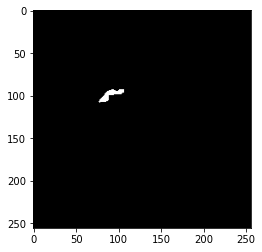

In [13]:
plt.imshow(cv2.imread(os.path.join(DATASET_FOLDER, brain_df.mask_path[623])))

### Visualize image and mask

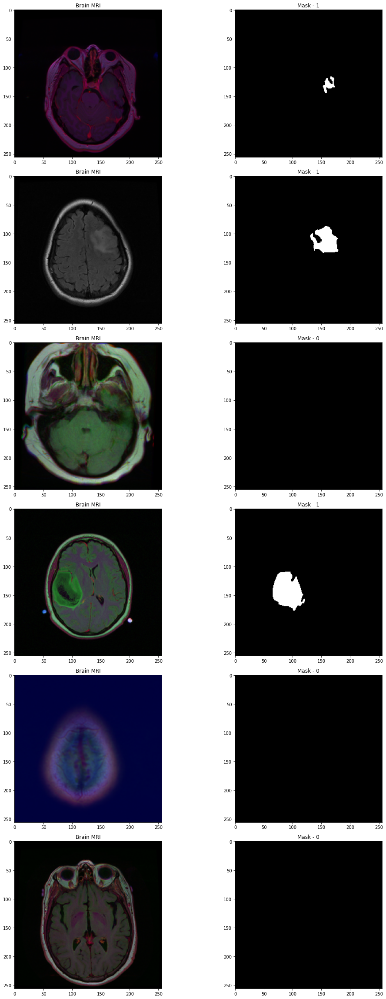

In [14]:
import random
fig, axs = plt.subplots(6,2, figsize=(16,32))
count = 0
for x in range(6):
  i = random.randint(0, len(brain_df)) # select a random index
  axs[count][0].title.set_text("Brain MRI") # set title
  axs[count][0].imshow(cv2.imread(os.path.join(DATASET_FOLDER, brain_df.image_path[i]))) # show MRI 
  axs[count][1].title.set_text("Mask - " + str(brain_df['mask'][i])) # plot title on the mask (0 or 1)
  axs[count][1].imshow(cv2.imread(os.path.join(DATASET_FOLDER, brain_df.mask_path[i]))) # Show corresponding mask
  count += 1

fig.tight_layout()

### Visualize image, mask and image with mask on top

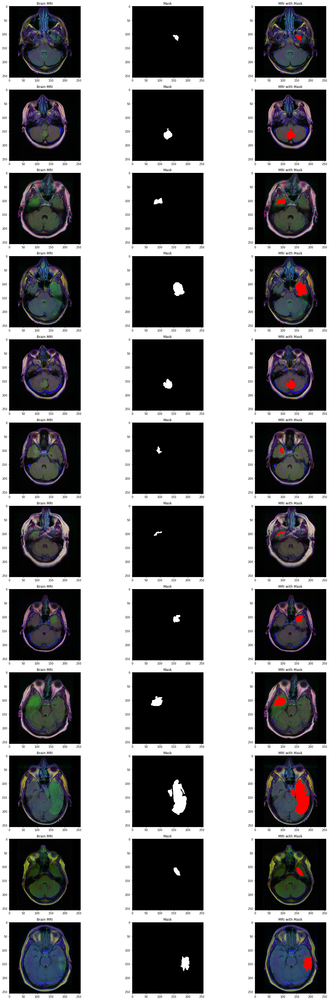

In [15]:
count = 0
fig, axs = plt.subplots(12, 3, figsize = (20, 50))
for i in range(len(brain_df)):
  if brain_df['mask'][i] ==1 and count <12:
    img = io.imread(os.path.join(DATASET_FOLDER, brain_df.image_path[i]))
    axs[count][0].title.set_text('Brain MRI')
    axs[count][0].imshow(img)

    mask = io.imread(os.path.join(DATASET_FOLDER, brain_df.mask_path[i]))
    axs[count][1].title.set_text('Mask')
    axs[count][1].imshow(mask, cmap = 'gray')

    
    img[mask == 255] = (255, 0, 0)
    axs[count][2].title.set_text('MRI with Mask')
    axs[count][2].imshow(img)
    count+=1

fig.tight_layout()


## Data cleaning and transforming

In [16]:
# Drop the patient id column
brain_df_train = brain_df.drop(columns = ['patient_id'])
brain_df_train.shape

(3929, 3)

In [17]:
def convert_to_jpeg(path):
    full_path = os.path.join(DATASET_FOLDER, path)
    jpeg_path = os.path.splitext(full_path)[0] + ".jpg"
    if not os.path.exists(jpeg_path):
        im = Image.open(full_path)
        im.thumbnail(im.size)
        im.save(jpeg_path, "JPEG", quality=100)
    return jpeg_path

In [18]:
    brain_df_train['image_path'] = brain_df_train['image_path'].apply(convert_to_jpeg)
    brain_df_train['mask_path'] = brain_df_train['mask_path'].apply(convert_to_jpeg)

In [19]:
brain_df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3929 entries, 0 to 3928
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   image_path  3929 non-null   object
 1   mask_path   3929 non-null   object
 2   mask        3929 non-null   int64 
dtypes: int64(1), object(2)
memory usage: 92.2+ KB


In [20]:
brain_df_train["image_path"][0]

'Dataset\\Brain_MRI\\TCGA_CS_5395_19981004/TCGA_CS_5395_19981004_1.jpg'

In [21]:
y = [value for value in brain_df_train['mask']]

In [22]:
# split the data into train and test data, use startify to get the same data distribution in both sets

from sklearn.model_selection import train_test_split

train, val = train_test_split(brain_df_train, test_size = 0.2, random_state = SEED, stratify = y)
val, test = train_test_split(val, test_size = 0.5, random_state = SEED)

In [23]:
train.to_csv(os.path.join(DATASET_FOLDER, "cleaned_train.csv"), index=False)
val.to_csv(os.path.join(DATASET_FOLDER, "cleaned_val.csv"), index=False)
test.to_csv(os.path.join(DATASET_FOLDER, "cleaned_test.csv"), index=False)

In [24]:
len_train_ds = train.count()[0]
len_test_ds = test.count()[0]
len_val_ds = val.count()[0]

In [25]:
from sklearn.utils import class_weight

counts = brain_df['mask'].value_counts()
weights = {k:v for k, v in zip(counts.index, counts.values)}
class_weights = class_weight.compute_class_weight('balanced', np.unique(y), y)
weights = {k:class_weights[i] for i, k in enumerate(weights.keys())}
print(weights)

{0: 0.7685837245696401, 1: 1.4308084486525856}


## Create CSV Dataset


In [26]:
train_dataset = tf.data.experimental.CsvDataset(os.path.join(DATASET_FOLDER, "cleaned_train.csv"), [tf.string, tf.string, tf.int32], header=True)
val_dataset = tf.data.experimental.CsvDataset(os.path.join(DATASET_FOLDER, "cleaned_val.csv"), [tf.string, tf.string, tf.int32], header=True)
test_dataset = tf.data.experimental.CsvDataset(os.path.join(DATASET_FOLDER, "cleaned_test.csv"), [tf.string, tf.string, tf.int32], header=True)

In [27]:
# this is not needed anymore since I use Resnet preprocess_input() function
image_preprocessing = tf.keras.Sequential(
    [
        tf.keras.layers.experimental.preprocessing.Resizing(256, 256, name="resize_layer"),
        tf.keras.layers.experimental.preprocessing.Rescaling(scale=1./255, name="rescaling_layer")
    ]
)

# use data augmentation for training set
data_augmentation = tf.keras.Sequential(
    [
        tf.keras.layers.experimental.preprocessing.RandomFlip("horizontal", seed=SEED, name="random_flip_layer"),
        tf.keras.layers.experimental.preprocessing.RandomRotation(0.1, fill_mode="constant", seed=SEED, name="random_rotation_layer"),
        tf.keras.layers.experimental.preprocessing.RandomZoom((-0.1, 0.1), fill_mode="constant", seed=SEED, name="random_zoom_layer"),
    ]
)

In [28]:
test = next(iter(val_dataset))
print(test[0])
print(test[1])
print(test[2])

tf.Tensor(b'Dataset\\Brain_MRI\\TCGA_DU_7018_19911220/TCGA_DU_7018_19911220_19.jpg', shape=(), dtype=string)
tf.Tensor(b'Dataset\\Brain_MRI\\TCGA_DU_7018_19911220/TCGA_DU_7018_19911220_19_mask.jpg', shape=(), dtype=string)
tf.Tensor(1, shape=(), dtype=int32)


In [29]:
img = tf.io.read_file("Dataset\\Brain_MRI\\TCGA_DU_7018_19911220/TCGA_DU_7018_19911220_19.jpg")
img = tf.image.decode_jpeg(img, channels=3)

In [30]:
img.shape

TensorShape([256, 256, 3])

In [31]:
def load_images(image_path, mask_path, label):
  img = tf.io.read_file(image_path)
  img = tf.image.decode_jpeg(img, channels=3)
  img = tf.keras.layers.experimental.preprocessing.Resizing(256, 256, name="resize_layer")(img)
  return img, label

def preprocess_and_augment_images(image, label):
    image = tf.expand_dims(image, axis=0)
    image = data_augmentation(image)
    image = tf.keras.applications.resnet.preprocess_input(image)
    return image[0], label

def preprocess_images(image, label):
    image = tf.expand_dims(image, axis=0)
    image = tf.keras.applications.resnet.preprocess_input(image)
    return image[0], label

In [32]:
train_dataset = train_dataset.map(load_images, num_parallel_calls=tf.data.experimental.AUTOTUNE)
train_dataset = train_dataset.map(preprocess_and_augment_images, num_parallel_calls=tf.data.experimental.AUTOTUNE).cache()
train_dataset = train_dataset.shuffle(len_train_ds, seed=SEED)
train_dataset = train_dataset.batch(BATCH_SIZE).prefetch(buffer_size=tf.data.experimental.AUTOTUNE)

In [33]:
val_dataset = val_dataset.map(load_images, num_parallel_calls=tf.data.experimental.AUTOTUNE)
val_dataset = val_dataset.map(preprocess_images, num_parallel_calls=tf.data.experimental.AUTOTUNE).cache()
val_dataset = val_dataset.batch(BATCH_SIZE)
val_dataset = val_dataset.prefetch(buffer_size=tf.data.experimental.AUTOTUNE)

In [34]:
test_dataset = test_dataset.map(load_images, num_parallel_calls=tf.data.experimental.AUTOTUNE)
test_dataset = test_dataset.map(preprocess_images, num_parallel_calls=tf.data.experimental.AUTOTUNE)
test_dataset = test_dataset.batch(BATCH_SIZE)
test_dataset = test_dataset.prefetch(buffer_size=tf.data.experimental.AUTOTUNE)

In [35]:
print(next(iter(val_dataset)))

(<tf.Tensor: shape=(32, 256, 256, 3), dtype=float32, numpy=
array([[[[-103.939, -115.779, -123.68 ],
         [-103.939, -115.779, -123.68 ],
         [-103.939, -116.779, -123.68 ],
         ...,
         [-103.939, -115.779, -123.68 ],
         [-103.939, -115.779, -123.68 ],
         [-103.939, -115.779, -123.68 ]],

        [[-103.939, -115.779, -123.68 ],
         [-103.939, -115.779, -123.68 ],
         [-103.939, -116.779, -123.68 ],
         ...,
         [-103.939, -115.779, -123.68 ],
         [-103.939, -115.779, -123.68 ],
         [-103.939, -115.779, -123.68 ]],

        [[-103.939, -115.779, -123.68 ],
         [-103.939, -115.779, -123.68 ],
         [-103.939, -116.779, -123.68 ],
         ...,
         [-103.939, -116.779, -123.68 ],
         [-103.939, -115.779, -123.68 ],
         [-103.939, -115.779, -123.68 ]],

        ...,

        [[-103.939, -116.779, -123.68 ],
         [-103.939, -116.779, -123.68 ],
         [-103.939, -115.779, -123.68 ],
         ...,
   

# Classification Model

In [36]:
# Get the ResNet101 base model
basemodel = ResNet101(weights = 'imagenet', include_top = False, input_tensor = Input(shape=(256, 256, 3)))

In [37]:
# freeze the base model weights
for layer in basemodel.layers:
  layer.trainable = False

In [38]:
# Add classification head to the base model

headmodel = basemodel.output
headmodel = AveragePooling2D(pool_size = (4,4))(headmodel)
headmodel = Flatten(name= 'flatten')(headmodel)
headmodel = Dense(256, activation = "relu")(headmodel)
headmodel = Dropout(0.3)(headmodel)
headmodel = Dense(512, activation = "relu")(headmodel)
headmodel = Dropout(0.3)(headmodel)
#headmodel = Dense(256, activation = "relu")(headmodel)
#headmodel = Dropout(0.3)(headmodel)
headmodel = Dense(1)(headmodel)
outputs = layers.Activation('sigmoid', dtype='float32', name='prediction')(headmodel)

model = Model(inputs = basemodel.input, outputs = outputs)

In [39]:
model.summary()

Model: "functional_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 262, 262, 3)  0           input_1[0][0]                    
__________________________________________________________________________________________________
conv1_conv (Conv2D)             (None, 128, 128, 64) 9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
conv1_bn (BatchNormalization)   (None, 128, 128, 64) 256         conv1_conv[0][0]                 
_______________________________________________________________________________________

In [40]:
# compile the model
opt = tf.keras.optimizers.Adam(learning_rate=0.001)
loss = tf.keras.losses.BinaryCrossentropy()
model.compile(loss = loss, optimizer=opt, metrics= ["accuracy"])

In [41]:
# use early stopping to exit training if validation loss is not decreasing even after certain epochs (patience)
earlystopping = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=30)
# use ReduceLROnPlateau to dynamically lower learning rate when validation loss doesn't diminish after 5 epochs
reduceLr = ReduceLROnPlateau(monitor='val_loss', mode='min', verbose=1, patience=5, factor=0.5, min_lr=0.00005)
# save the best model with least validation loss
checkpointer = ModelCheckpoint(filepath= os.path.join( MODEL_FOLDER, "classifier_resnet_weights_ds.hdf5"), verbose=1, save_best_only=True, save_weights_only=True, monitor="val_loss")
# use tensorboard
classification_log_dir = os.path.join(BASE_FOLDER, "logs", "classification", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard = TensorBoard(log_dir=classification_log_dir, histogram_freq=1)

In [42]:
history = model.fit(train_dataset, epochs = 100, validation_data= val_dataset, callbacks=[checkpointer, earlystopping, reduceLr, tensorboard], class_weight=weights)

Epoch 1/100
      1/Unknown - 0s 0s/step - loss: 0.7467 - accuracy: 0.4375WARNING:tensorflow:From C:\ProgramData\Miniconda3\lib\site-packages\tensorflow\python\ops\summary_ops_v2.py:1277: stop (from tensorflow.python.eager.profiler) is deprecated and will be removed after 2020-07-01.
Instructions for updating:
use `tf.profiler.experimental.stop` instead.
      2/Unknown - 1s 270ms/step - loss: 0.8953 - accuracy: 0.4844WARNING:tensorflow:Callbacks method `on_train_batch_end` is slow compared to the batch time (batch time: 0.0600s vs `on_train_batch_end` time: 0.4807s). Check your callbacks.
     99/Unknown - 6s 60ms/step - loss: 0.5722 - accuracy: 0.7426
Epoch 00001: val_loss improved from inf to 0.36703, saving model to Models\classifier_resnet_weights_ds.hdf5
99/99 [==============================] - 16s 163ms/step - loss: 0.5722 - accuracy: 0.7426 - val_loss: 0.3670 - val_accuracy: 0.8321
Epoch 2/100
98/99 [============================>.] - ETA: 0s - loss: 0.3851 - accuracy: 0.7937
Ep

In [43]:
# save the model architecture to json file for future use

model_json = model.to_json()
with open(os.path.join(MODEL_FOLDER, "classifier_resnet_ds_model.json"),"w") as json_file:
  json_file.write(model_json)

In [44]:
# Load pretrained model
with open(os.path.join(MODEL_FOLDER, "classifier_resnet_ds_model.json"), "r") as json_file:
    json_savedModel= json_file.read()
# load the model with its weights
model = tf.keras.models.model_from_json(json_savedModel)
model.load_weights(os.path.join(MODEL_FOLDER, "classifier_resnet_weights_ds.hdf5"))


In [45]:
for layer in model.layers:
    layer.trainable = True

opt = tf.keras.optimizers.Adam(learning_rate=0.0001)
loss = tf.keras.losses.BinaryCrossentropy()
model.compile(loss=loss, optimizer=opt, metrics= ["accuracy"])

# use early stopping to exit training if validation loss is not decreasing even after certain epochs (patience)
earlystopping = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=20)
# use ReduceLROnPlateau to dynamically lower learning rate when validation loss doesn't diminish after 5 epochs
reduceLr = ReduceLROnPlateau(monitor='val_loss', mode='min', verbose=1, patience=5, factor=0.75, min_lr=0.000001)
# save the best model with least validation loss
checkpointer = ModelCheckpoint(filepath= os.path.join( MODEL_FOLDER, "classifier_resnet_refined_weights_ds.hdf5"), verbose=1, save_best_only=True, monitor="val_loss", save_weights_only=True)
# use tensorboard
classification_log_dir = os.path.join("logs", "classification-refined", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard = TensorBoard(log_dir=classification_log_dir, histogram_freq=1)

In [46]:
history_refined = model.fit(train_dataset, epochs = 100, validation_data= val_dataset, callbacks=[checkpointer, earlystopping, reduceLr, tensorboard], class_weight=weights)

Epoch 1/100
      2/Unknown - 2s 826ms/step - loss: 4.2733 - accuracy: 0.6719WARNING:tensorflow:Callbacks method `on_train_batch_end` is slow compared to the batch time (batch time: 0.1980s vs `on_train_batch_end` time: 1.4534s). Check your callbacks.
     99/Unknown - 21s 213ms/step - loss: 0.5260 - accuracy: 0.8326
Epoch 00001: val_loss improved from inf to 0.51269, saving model to Models\classifier_resnet_refined_weights_ds.hdf5
99/99 [==============================] - 34s 342ms/step - loss: 0.5260 - accuracy: 0.8326 - val_loss: 0.5127 - val_accuracy: 0.8550
Epoch 2/100
99/99 [==============================] - ETA: 0s - loss: 0.1928 - accuracy: 0.9370
Epoch 00002: val_loss improved from 0.51269 to 0.19231, saving model to Models\classifier_resnet_refined_weights_ds.hdf5
99/99 [==============================] - 27s 271ms/step - loss: 0.1928 - accuracy: 0.9370 - val_loss: 0.1923 - val_accuracy: 0.9237
Epoch 3/100
99/99 [==============================] - ETA: 0s - loss: 0.1211 - accura

In [47]:
model.load_weights(os.path.join(MODEL_FOLDER, "classifier_resnet_refined_weights_ds.hdf5"))

In [48]:
test_predict = model.predict(test_dataset, verbose=1)

13/13 [==============================] - 3s 204ms/step


In [49]:
test_predict.shape

(393, 1)

In [50]:
# Obtain the predicted class from the model prediction
predict = []

for i in test_predict:
  predict.append(0 if i < 0.5 else 1)

predict = np.asarray(predict)
print(len(predict))

393


In [51]:
test = pd.read_csv(os.path.join(DATASET_FOLDER, "cleaned_test.csv"))

In [52]:
original = np.asarray(test['mask'])[:len(predict)]
len(original)

393

In [53]:
# Obtain the accuracy of the model
from sklearn.metrics import accuracy_score

accuracy = accuracy_score(original, predict)
accuracy

0.9465648854961832

<AxesSubplot:>

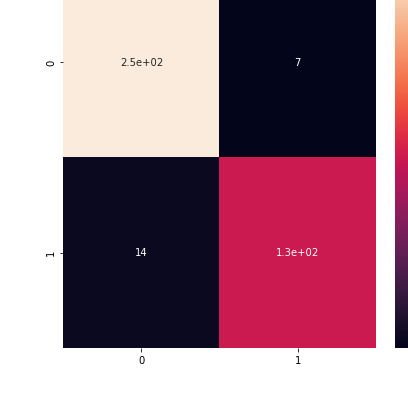

In [54]:
# plot the confusion matrix
from sklearn.metrics import confusion_matrix

cm = confusion_matrix(original, predict)
plt.figure(figsize = (7,7))
sns.heatmap(cm, annot=True)

In [55]:
from sklearn.metrics import classification_report

report = classification_report(original, predict, labels = [0,1])
print(report)

              precision    recall  f1-score   support

           0       0.95      0.97      0.96       253
           1       0.95      0.90      0.92       140

    accuracy                           0.95       393
   macro avg       0.95      0.94      0.94       393
weighted avg       0.95      0.95      0.95       393



In [56]:
model.save(os.path.join(MODEL_FOLDER, 'saved_model_classifier_ds'), include_optimizer=False)

Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.
Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.
INFO:tensorflow:Assets written to: Models\saved_model_classifier_ds\assets


# Segmentation model

In [57]:
# Get the dataframe containing MRIs which have masks associated with them.
brain_df_mask = brain_df[brain_df['mask'] == 1]
brain_df_mask.shape

(1373, 4)

In [58]:
brain_df_mask.drop(columns=["patient_id", "mask"], inplace=True)
brain_df_mask['image_path'] = brain_df_mask['image_path'].apply(convert_to_jpeg)
brain_df_mask['mask_path'] = brain_df_mask['mask_path'].apply(convert_to_jpeg)
brain_df_mask.head()

,image_path,mask_path
445,Dataset\Brain_MRI\TCGA_CS_5393_19990606/TCGA_C...,Dataset\Brain_MRI\TCGA_CS_5393_19990606/TCGA_C...
507,Dataset\Brain_MRI\TCGA_HT_7680_19970202/TCGA_H...,Dataset\Brain_MRI\TCGA_HT_7680_19970202/TCGA_H...
551,Dataset\Brain_MRI\TCGA_CS_4944_20010208/TCGA_C...,Dataset\Brain_MRI\TCGA_CS_4944_20010208/TCGA_C...
555,Dataset\Brain_MRI\TCGA_CS_5393_19990606/TCGA_C...,Dataset\Brain_MRI\TCGA_CS_5393_19990606/TCGA_C...
617,Dataset\Brain_MRI\TCGA_HT_7680_19970202/TCGA_H...,Dataset\Brain_MRI\TCGA_HT_7680_19970202/TCGA_H...


In [59]:
brain_df_mask.to_csv(os.path.join(DATASET_FOLDER, "segmentations.csv"), index=False)

In [60]:
seg_train, seg_val = train_test_split(brain_df_mask, test_size = 0.2, random_state = SEED)
seg_val, seg_test = train_test_split(seg_val, test_size = 0.5, random_state = SEED)

In [61]:
seg_train.to_csv(os.path.join(DATASET_FOLDER, "seg_train.csv"), index=False)
seg_val.to_csv(os.path.join(DATASET_FOLDER, "seg_val.csv"), index=False)
seg_test.to_csv(os.path.join(DATASET_FOLDER, "seg_test.csv"), index=False)

In [62]:
len_seg_train = seg_train.count()[0]

In [63]:
seg_train_dataset = tf.data.experimental.CsvDataset(os.path.join(DATASET_FOLDER, "seg_train.csv"), [tf.string, tf.string], header=True)
seg_val_dataset = tf.data.experimental.CsvDataset(os.path.join(DATASET_FOLDER, "seg_val.csv"), [tf.string, tf.string], header=True)
seg_test_dataset = tf.data.experimental.CsvDataset(os.path.join(DATASET_FOLDER, "seg_test.csv"), [tf.string, tf.string], header=True)

In [64]:
def preprocess_segmentation(image_path, mask_path):
  image = tf.io.read_file(image_path)
  image = tf.image.decode_jpeg(image, channels=3)
  image = tf.keras.layers.experimental.preprocessing.Resizing(256, 256, name="resize_layer")(image)
  image = tf.cast(image, dtype=tf.float32)
  image = tf.image.per_image_standardization(image)

  mask = tf.io.read_file(mask_path)
  mask = tf.image.decode_jpeg(mask)
  mask = tf.keras.layers.experimental.preprocessing.Resizing(256, 256, name="resize_layer")(mask)
  mask = tf.cast(mask, dtype=tf.float32)
  mask = tf.image.per_image_standardization(mask)
  mask =  tf.cast(mask > 0, tf.float32)
  return image, mask

In [65]:
seg_train_dataset = seg_train_dataset.map(preprocess_segmentation, num_parallel_calls=tf.data.experimental.AUTOTUNE)
seg_train_dataset = seg_train_dataset.cache()
seg_train_dataset = seg_train_dataset.shuffle(len_seg_train, seed=SEED)
seg_train_dataset = seg_train_dataset.batch(BATCH_SIZE).prefetch(buffer_size=tf.data.experimental.AUTOTUNE)

In [66]:
seg_val_dataset = seg_val_dataset.map(preprocess_segmentation, num_parallel_calls=tf.data.experimental.AUTOTUNE)
seg_val_dataset = seg_val_dataset.cache()
seg_val_dataset = seg_val_dataset.batch(BATCH_SIZE).prefetch(buffer_size=tf.data.experimental.AUTOTUNE)

In [67]:
seg_test_dataset = seg_test_dataset.map(preprocess_segmentation, num_parallel_calls=tf.data.experimental.AUTOTUNE)
seg_test_dataset = seg_test_dataset.cache()
seg_test_dataset = seg_test_dataset.batch(BATCH_SIZE).prefetch(buffer_size=tf.data.experimental.AUTOTUNE)

In [68]:
t = next(iter(seg_train_dataset))

In [69]:
print(type(t))
print(type(t[0]))
print(t[0].shape)
print(type(t[1]))
print(t[1].shape)

<class 'tuple'>
<class 'tensorflow.python.framework.ops.EagerTensor'>
(32, 256, 256, 3)
<class 'tensorflow.python.framework.ops.EagerTensor'>
(32, 256, 256, 1)


In [70]:
tf.math.reduce_max(t[0])

<tf.Tensor: shape=(), dtype=float32, numpy=9.495632>

In [71]:
tf.math.reduce_min(t[0])

<tf.Tensor: shape=(), dtype=float32, numpy=-1.0432918>

In [72]:
tf.math.reduce_max(t[1])

<tf.Tensor: shape=(), dtype=float32, numpy=1.0>

In [73]:
tf.math.reduce_min(t[1])

<tf.Tensor: shape=(), dtype=float32, numpy=0.0>

In [74]:
# Float16 operations are not precise enough for this, they result in loss of 1 everytime, so switch back to float32
tf.keras.mixed_precision.experimental.set_policy('float32')

In [75]:
def tversky(y_true, y_pred, smooth = 1e-6):
    y_true_pos = K.flatten(tf.cast(y_true, tf.float32))
    y_pred_pos = K.flatten(y_pred)
    true_pos = K.sum(y_true_pos * y_pred_pos)
    false_neg = K.sum(y_true_pos * (1-y_pred_pos))
    false_pos = K.sum((1-y_true_pos)*y_pred_pos)
    alpha = 0.7
    return (true_pos + smooth)/(true_pos + alpha*false_neg + (1-alpha)*false_pos + smooth)

def tversky_loss(y_true, y_pred):
    return 1 - tversky(y_true,y_pred)

def focal_tversky(y_true,y_pred):
    pt_1 = tversky(y_true, y_pred)
    gamma = 0.75
    return K.pow((1-pt_1), gamma)

In [76]:
def resblock(X, f):
  
  # make a copy of input
  X_copy = X

  # main path
  X = Conv2D(f, kernel_size = (1,1) ,strides = (1,1),kernel_initializer ='he_normal')(X)
  X = BatchNormalization()(X)
  X = Activation('relu')(X) 

  X = Conv2D(f, kernel_size = (3,3), strides =(1,1), padding = 'same', kernel_initializer ='he_normal')(X)
  X = BatchNormalization()(X)

  # Short path
  X_copy = Conv2D(f, kernel_size = (1,1), strides =(1,1), kernel_initializer ='he_normal')(X_copy)
  X_copy = BatchNormalization()(X_copy)

  # Adding the output from main path and short path together
  X = Add()([X,X_copy])
  X = Activation('relu')(X)

  return X

In [77]:
# function to upscale and concatenate the values passsed
def upsample_concat(x, skip):
  x = UpSampling2D((2,2))(x)
  merge = Concatenate()([x, skip])

  return merge

In [78]:
def build_segmentation_model():
    input_shape = (256,256,3)

    # Input tensor shape
    X_input = Input(input_shape)

    # Stage 1
    conv1_in = Conv2D(16,3,activation= 'relu', padding = 'same', kernel_initializer ='he_normal')(X_input)
    conv1_in = BatchNormalization()(conv1_in)
    conv1_in = Conv2D(16,3,activation= 'relu', padding = 'same', kernel_initializer ='he_normal')(conv1_in)
    conv1_in = BatchNormalization()(conv1_in)
    pool_1 = MaxPool2D(pool_size = (2,2))(conv1_in)

    # Stage 2
    conv2_in = resblock(pool_1, 32)
    pool_2 = MaxPool2D(pool_size = (2,2))(conv2_in)

    # Stage 3
    conv3_in = resblock(pool_2, 64)
    pool_3 = MaxPool2D(pool_size = (2,2))(conv3_in)

    # Stage 4
    conv4_in = resblock(pool_3, 128)
    pool_4 = MaxPool2D(pool_size = (2,2))(conv4_in)

    # Stage 5 (Bottle Neck)
    conv5_in = resblock(pool_4, 256)

    # Upscale stage 1
    up_1 = upsample_concat(conv5_in, conv4_in)
    up_1 = resblock(up_1, 128)

    # Upscale stage 2
    up_2 = upsample_concat(up_1, conv3_in)
    up_2 = resblock(up_2, 64)

    # Upscale stage 3
    up_3 = upsample_concat(up_2, conv2_in)
    up_3 = resblock(up_3, 32)

    # Upscale stage 4
    up_4 = upsample_concat(up_3, conv1_in)
    up_4 = resblock(up_4, 16)

    # Final Output
    output = Conv2D(1, (1,1), padding = "same", activation = "sigmoid")(up_4)

    return Model(inputs = X_input, outputs = output )

In [84]:
model_seg = build_segmentation_model()

In [85]:
model_seg.summary()

Model: "functional_5"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
conv2d_27 (Conv2D)              (None, 256, 256, 16) 448         input_3[0][0]                    
__________________________________________________________________________________________________
batch_normalization_26 (BatchNo (None, 256, 256, 16) 64          conv2d_27[0][0]                  
__________________________________________________________________________________________________
conv2d_28 (Conv2D)              (None, 256, 256, 16) 2320        batch_normalization_26[0][0]     
_______________________________________________________________________________________

In [86]:
# Compile the model
adam_seg = tf.keras.optimizers.Adam(lr = 0.01)
model_seg.compile(optimizer = adam_seg, loss = focal_tversky, metrics = [tversky])

In [87]:
earlystopping_seg = EarlyStopping(monitor='val_tversky', mode='max', verbose=1, patience=30)
reduceLr_seg = ReduceLROnPlateau(monitor='val_tversky', mode='max', verbose=1, patience=10, factor=0.5, min_lr=0.0001)
checkpointer_seg = ModelCheckpoint(monitor='val_tversky', mode='max', filepath=os.path.join(MODEL_FOLDER, "ResUNet_weights_ds.hdf5"), verbose=1, save_best_only=True, save_weights_only=True)
segmentation_log_dir_seg = os.path.join("logs", "segmentation", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_seg = TensorBoard(log_dir=segmentation_log_dir_seg, histogram_freq=1)

In [88]:
seg_history = model_seg.fit(seg_train_dataset, epochs = 100, validation_data = seg_val_dataset, callbacks = [earlystopping_seg, reduceLr_seg, checkpointer_seg, tensorboard_seg])

Epoch 1/100
      2/Unknown - 1s 372ms/step - loss: 0.8878 - tversky: 0.1467WARNING:tensorflow:Callbacks method `on_train_batch_end` is slow compared to the batch time (batch time: 0.0170s vs `on_train_batch_end` time: 0.7258s). Check your callbacks.
     35/Unknown - 7s 196ms/step - loss: 0.6079 - tversky: 0.4831WARNING:tensorflow:Callbacks method `on_test_batch_end` is slow compared to the batch time (batch time: 0.0110s vs `on_test_batch_end` time: 0.0440s). Check your callbacks.

Epoch 00001: val_tversky improved from -inf to 0.09530, saving model to Models\ResUNet_weights_ds.hdf5
35/35 [==============================] - 9s 267ms/step - loss: 0.6079 - tversky: 0.4831 - val_loss: 0.9304 - val_tversky: 0.0953
Epoch 2/100
35/35 [==============================] - ETA: 0s - loss: 0.4016 - tversky: 0.7039
Epoch 00002: val_tversky improved from 0.09530 to 0.12755, saving model to Models\ResUNet_weights_ds.hdf5
35/35 [==============================] - 7s 213ms/step - loss: 0.4016 - tversky

In [89]:
# save the model architecture to json file for future use

model_json_seg = model_seg.to_json()
with open(os.path.join(MODEL_FOLDER, "ResUNet_model_ds.json"),"w") as json_file:
  json_file.write(model_json_seg)

In [90]:
model_seg.load_weights(os.path.join(MODEL_FOLDER, "ResUNet_weights_ds.hdf5"))
model_seg.save(os.path.join(MODEL_FOLDER, "saved_model_segmentation_ds"), include_optimizer=False)

INFO:tensorflow:Assets written to: Models\saved_model_segmentation_ds\assets


In [91]:
def prediction(test, model, model_seg):

  #Creating empty list to store the results
  mask = []
  image_id = []
  has_mask = []

  #iterating through each image in the test data
  for i in test.image_path:

    path = str(i)
    img = tf.io.read_file(path)
    img = tf.image.decode_jpeg(img, channels=3)
    img = tf.keras.layers.experimental.preprocessing.Resizing(256, 256, name="resize_layer")(img)
    img = tf.expand_dims(img, axis=0)
    
    img_classification = tf.keras.applications.resnet.preprocess_input(img)

    #making prediction on the image
    is_defect = model.predict(img_classification)
    is_defect = 0 if is_defect < 0.5 else 1

    #if tumour is not present we append the details of the image to the list
    if is_defect == 0:
      image_id.append(i)
      has_mask.append(0)
      mask.append('No mask')
      continue

    #Read the image
    img_segmentation = tf.image.per_image_standardization(img)

    #make prediction
    predict = model_seg.predict(img_segmentation)

    #if the sum of predicted values is equal to 0 then there is no tumour
    if predict.round().astype(int).sum() == 0:
        image_id.append(i)
        has_mask.append(0)
        mask.append('No mask')
    else:
    #if the sum of pixel values are more than 0, then there is tumour
        image_id.append(i)
        has_mask.append(1)
        mask.append(predict)


  return image_id, mask, has_mask

In [92]:
model = tf.keras.models.load_model(os.path.join(MODEL_FOLDER, "saved_model_classifier_ds"), compile=False)

In [93]:
# Need to check this ...
model_seg = tf.keras.models.load_model(os.path.join(MODEL_FOLDER, "saved_model_segmentation_ds"), compile=False)

ValueError: Unable to restore custom object of type _tf_keras_metric currently. Please make sure that the layer implements `get_config`and `from_config` when saving. In addition, please use the `custom_objects` arg when calling `load_model()`.

In [94]:
model_seg = build_segmentation_model()
model_seg.load_weights(os.path.join(MODEL_FOLDER, "ResUNet_weights_ds.hdf5"))

In [95]:
image_id, mask, has_mask = prediction(test, model, model_seg)

In [96]:
# creating a dataframe for the result
df_pred = pd.DataFrame({'image_path': image_id,'predicted_mask': mask,'has_mask': has_mask})
df_pred

,image_path,predicted_mask,has_mask
0,Dataset\Brain_MRI\TCGA_CS_6668_20011025/TCGA_C...,No mask,0
1,Dataset\Brain_MRI\TCGA_DU_7008_19830723/TCGA_D...,No mask,0
2,Dataset\Brain_MRI\TCGA_HT_7684_19950816/TCGA_H...,No mask,0
3,Dataset\Brain_MRI\TCGA_HT_7690_19960312/TCGA_H...,"[[[[2.2521735e-06], [1.6562259e-06], [5.555945...",1
4,Dataset\Brain_MRI\TCGA_DU_6399_19830416/TCGA_D...,"[[[[1.4575459e-06], [1.122608e-06], [4.0156883...",1
...,...,...,...
388,Dataset\Brain_MRI\TCGA_FG_7643_20021104/TCGA_F...,No mask,0
389,Dataset\Brain_MRI\TCGA_DU_A5TU_19980312/TCGA_D...,No mask,0
390,Dataset\Brain_MRI\TCGA_DU_5872_19950223/TCGA_D...,"[[[[2.441116e-06], [1.8272927e-06], [6.402549e...",1
391,Dataset\Brain_MRI\TCGA_DU_A5TP_19970614/TCGA_D...,No mask,0


In [97]:
# Merge the dataframe containing predicted results with the original test data.
df_pred = test.merge(df_pred, on = 'image_path')
df_pred.head()

,image_path,mask_path,mask,predicted_mask,has_mask
0,Dataset\Brain_MRI\TCGA_CS_6668_20011025/TCGA_C...,Dataset\Brain_MRI\TCGA_CS_6668_20011025/TCGA_C...,0,No mask,0
1,Dataset\Brain_MRI\TCGA_DU_7008_19830723/TCGA_D...,Dataset\Brain_MRI\TCGA_DU_7008_19830723/TCGA_D...,0,No mask,0
2,Dataset\Brain_MRI\TCGA_HT_7684_19950816/TCGA_H...,Dataset\Brain_MRI\TCGA_HT_7684_19950816/TCGA_H...,0,No mask,0
3,Dataset\Brain_MRI\TCGA_HT_7690_19960312/TCGA_H...,Dataset\Brain_MRI\TCGA_HT_7690_19960312/TCGA_H...,1,"[[[[2.2521735e-06], [1.6562259e-06], [5.555945...",1
4,Dataset\Brain_MRI\TCGA_DU_6399_19830416/TCGA_D...,Dataset\Brain_MRI\TCGA_DU_6399_19830416/TCGA_D...,1,"[[[[1.4575459e-06], [1.122608e-06], [4.0156883...",1


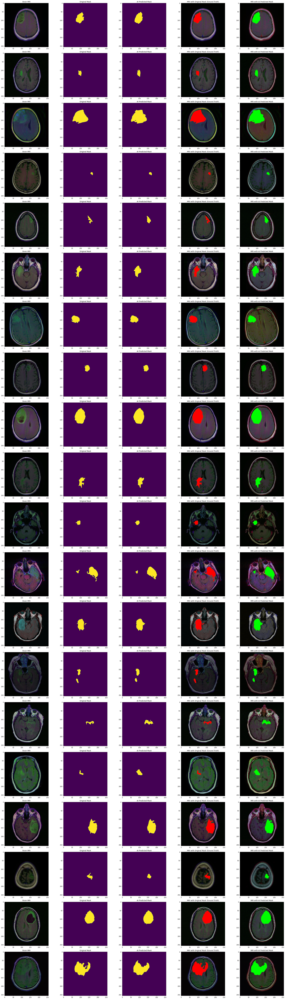

In [98]:
count = 0 
fig, axs = plt.subplots(20, 5, figsize=(30, 100))
for i in range(len(df_pred)):
  if df_pred['has_mask'][i] == 1 and count < 20:
    img = io.imread(df_pred.image_path[i])
    axs[count][0].title.set_text("Brain MRI")
    axs[count][0].imshow(img)

    # Obtain the mask for the image 
    mask = io.imread(df_pred.mask_path[i])
    axs[count][1].title.set_text("Original Mask")
    axs[count][1].imshow(mask)

    # Obtain the predicted mask for the image 
    predicted_mask = np.asarray(df_pred.predicted_mask[i])[0].squeeze().round()
    axs[count][2].title.set_text("AI Predicted Mask")
    axs[count][2].imshow(predicted_mask)
    
    # Apply the mask to the image 'mask==255'
    img[mask == 255] = (255, 0, 0)
    axs[count][3].title.set_text("MRI with Original Mask (Ground Truth)")
    axs[count][3].imshow(img)

    img_ = io.imread(df_pred.image_path[i])
    img_ = cv2.cvtColor(img_, cv2.COLOR_BGR2RGB)
    img_[predicted_mask == 1] = (0, 255, 0)
    axs[count][4].title.set_text("MRI with AI Predicted Mask")
    axs[count][4].imshow(img_)
    count += 1

fig.tight_layout()